In [1]:
#Python version 3.9.13  #conda version 23.1.0

In [2]:
import pandas as pd #version 1.4.4
import sklearn as skl #version 1.0.2
import pandas_profiling as pp #version 3.6.6
import numpy as np #version 1.21.5
import matplotlib.pyplot as plt #version 3.5.2
import warnings as ww

from sklearn.model_selection import train_test_split #version 1.0.2
from sklearn.linear_model import LogisticRegression #version1.0.2
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis #version 1.0.2
from sklearn import metrics
from sklearn.metrics import accuracy_score #version 1.0.2
from sklearn.metrics import precision_score #version 1.0.2
from sklearn.metrics import recall_score #version 1.0.2
from sklearn.metrics import confusion_matrix #version 1.0.2
from sklearn.metrics import roc_auc_score #version 1.0.2

ww.filterwarnings("ignore")

%matplotlib inline

/var/folders/00/zf18np857gbg8pz_r_jnmjsw0000gn/T/ipykernel_97406/3639567768.py:3: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling as pp #version 3.6.6


In [3]:
# this function gives the versions of the packages used in the code

#pip list

## 1

In [4]:
#this function reads in the data set

loan_defaults= pd.read_csv("/Users/christinegurek/Desktop/GitHub/DATA-300-Statistical-Machine-Learning-Fall-2023-/Data/loan_default_data_set-2.csv")
loan_defaults

,tot_balance,avg_bal_cards,credit_age,credit_age_good_account,credit_card_age,num_acc_30d_past_due_12_months,num_acc_30d_past_due_6_months,num_mortgage_currently_past_due,tot_amount_currently_past_due,num_inq_12_month,...,num_card_12_month,num_auto_ 36_month,uti_open_card,pct_over_50_uti,uti_max_credit_line,pct_card_over_50_uti,ind_XYZ,rep_income,rep_education,Def_ind
0,102956.11010,14819.057400,238,104,264,0,0,0,0.000000,0,...,1,0,0.366737,0.342183,0.513934,0.550866,0,118266.32130,college,0
1,132758.72580,18951.934550,384,197,371,0,0,0,0.000000,0,...,0,0,0.490809,0.540671,0.418016,NaN,0,89365.05765,college,0
2,124658.91740,15347.929690,277,110,288,0,0,0,0.000000,0,...,0,0,0.359074,0.338560,0.341627,0.451417,0,201365.12130,college,0
3,133968.53690,14050.713340,375,224,343,0,0,0,0.000000,2,...,1,0,0.700379,0.683589,0.542940,0.607843,0,191794.48550,college,0
4,143601.80170,14858.515270,374,155,278,0,0,0,0.000000,0,...,0,0,0.647351,0.510812,0.632934,0.573680,0,161465.36790,graduate,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,89665.13930,11521.159950,319,139,363,0,0,0,0.000000,0,...,0,0,0.535628,0.634712,0.527230,0.602345,0,NaN,high_school,0
19996,136211.63530,17977.054130,297,137,273,0,0,0,0.000000,2,...,0,0,0.464774,0.450030,0.545108,NaN,1,NaN,high_school,0
19997,110721.87650,13316.820540,304,151,257,0,0,0,0.000000,0,...,0,0,0.264544,0.340289,0.412155,NaN,0,157706.15810,college,0
19998,96742.36371,11743.262370,275,141,294,2,1,1,3009.387661,0,...,0,0,0.609226,0.582007,0.301612,0.697052,1,97387.97414,college,1


In [5]:
# this function tells us the shape of the data, in this case there are 21 columns and 20000 rows

loan_defaults.shape

(20000, 21)

In [6]:
# this function tells us the different column names

loan_defaults.columns

Index(['tot_balance', 'avg_bal_cards', 'credit_age', 'credit_age_good_account',
       'credit_card_age', 'num_acc_30d_past_due_12_months',
       'num_acc_30d_past_due_6_months', 'num_mortgage_currently_past_due',
       'tot_amount_currently_past_due', 'num_inq_12_month',
       'num_card_inq_24_month', 'num_card_12_month', 'num_auto_ 36_month',
       'uti_open_card', 'pct_over_50_uti', 'uti_max_credit_line',
       'pct_card_over_50_uti', 'ind_XYZ', 'rep_income', 'rep_education',
       'Def_ind'],
      dtype='object')

In [7]:
# this function runs many explanatory tests on the data to give us a better picture of what the data may look like 
# or characteristics of the data that we may not see through manual EDA

pp.ProfileReport(loan_defaults)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

1. This data is very interesting, there are lots of missing vaules within the data, it is quite imbalanced, and there seems to be a lot of multicollinearity, but it can also be very informative about loan defaulting with the correctly executed model.

In [8]:
# this function tells us how many values are missing in each column of the data set, if any

loan_defaults.isna().sum()

tot_balance                           0
avg_bal_cards                         0
credit_age                            0
credit_age_good_account               0
credit_card_age                       0
num_acc_30d_past_due_12_months        0
num_acc_30d_past_due_6_months         0
num_mortgage_currently_past_due       0
tot_amount_currently_past_due         0
num_inq_12_month                      0
num_card_inq_24_month                 0
num_card_12_month                     0
num_auto_ 36_month                    0
uti_open_card                         0
pct_over_50_uti                       0
uti_max_credit_line                   0
pct_card_over_50_uti               1958
ind_XYZ                               0
rep_income                         1559
rep_education                         1
Def_ind                               0
dtype: int64

a. the pct_card_over_50_uti, the rep_income, and the rep_education columns are all missing values. To impute these values I will put in the place the mean of the values in the columns pct_card_over_50_uti and rep_income respectively. Since rep_education is a categorical value and there is only one value missing, I will just drop the data point.

In [9]:
# this function replaces the missing values in the pct_card_over_50_uti column with the mean value of 
# the given values in the column

loan_defaults["pct_card_over_50_uti"] = loan_defaults["pct_card_over_50_uti"].fillna(loan_defaults["pct_card_over_50_uti"].mean())

In [10]:
# this function replaces the missing values in the rep_income column with the mean value of 
# the given values in the column

loan_defaults["rep_income"] = loan_defaults["rep_income"].fillna(loan_defaults["rep_income"].mean())

In [11]:
# this function drops the data point that still has a missing value, which is in the rep_education column

loan_defaults = loan_defaults.dropna()

In [12]:
# I ran this to double check everything was replaced effectively and correctly

loan_defaults

,tot_balance,avg_bal_cards,credit_age,credit_age_good_account,credit_card_age,num_acc_30d_past_due_12_months,num_acc_30d_past_due_6_months,num_mortgage_currently_past_due,tot_amount_currently_past_due,num_inq_12_month,...,num_card_12_month,num_auto_ 36_month,uti_open_card,pct_over_50_uti,uti_max_credit_line,pct_card_over_50_uti,ind_XYZ,rep_income,rep_education,Def_ind
0,102956.11010,14819.057400,238,104,264,0,0,0,0.000000,0,...,1,0,0.366737,0.342183,0.513934,0.550866,0,118266.321300,college,0
1,132758.72580,18951.934550,384,197,371,0,0,0,0.000000,0,...,0,0,0.490809,0.540671,0.418016,0.550964,0,89365.057650,college,0
2,124658.91740,15347.929690,277,110,288,0,0,0,0.000000,0,...,0,0,0.359074,0.338560,0.341627,0.451417,0,201365.121300,college,0
3,133968.53690,14050.713340,375,224,343,0,0,0,0.000000,2,...,1,0,0.700379,0.683589,0.542940,0.607843,0,191794.485500,college,0
4,143601.80170,14858.515270,374,155,278,0,0,0,0.000000,0,...,0,0,0.647351,0.510812,0.632934,0.573680,0,161465.367900,graduate,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,89665.13930,11521.159950,319,139,363,0,0,0,0.000000,0,...,0,0,0.535628,0.634712,0.527230,0.602345,0,166373.900129,high_school,0
19996,136211.63530,17977.054130,297,137,273,0,0,0,0.000000,2,...,0,0,0.464774,0.450030,0.545108,0.550964,1,166373.900129,high_school,0
19997,110721.87650,13316.820540,304,151,257,0,0,0,0.000000,0,...,0,0,0.264544,0.340289,0.412155,0.550964,0,157706.158100,college,0
19998,96742.36371,11743.262370,275,141,294,2,1,1,3009.387661,0,...,0,0,0.609226,0.582007,0.301612,0.697052,1,97387.974140,college,1


In [13]:
# I ran this to check and make sure all of the missing values were imputed or dropped

loan_defaults.isna().sum()

tot_balance                        0
avg_bal_cards                      0
credit_age                         0
credit_age_good_account            0
credit_card_age                    0
num_acc_30d_past_due_12_months     0
num_acc_30d_past_due_6_months      0
num_mortgage_currently_past_due    0
tot_amount_currently_past_due      0
num_inq_12_month                   0
num_card_inq_24_month              0
num_card_12_month                  0
num_auto_ 36_month                 0
uti_open_card                      0
pct_over_50_uti                    0
uti_max_credit_line                0
pct_card_over_50_uti               0
ind_XYZ                            0
rep_income                         0
rep_education                      0
Def_ind                            0
dtype: int64

In [14]:
# this function tells us how many values are in each category of the rep_education column

loan_defaults["rep_education"].value_counts()

college        12137
high_school     5314
graduate        2406
other            142
Name: rep_education, dtype: int64

b. In this data set the other category is underrepresented in the rep_education column.

c. No they are not balanced, num_acc_30d_past_due_6_months, num_mortgage_currently_past_due, num_card_12_month, num_auto_36_month, Def_ind columns speficially are highly imbalanced.

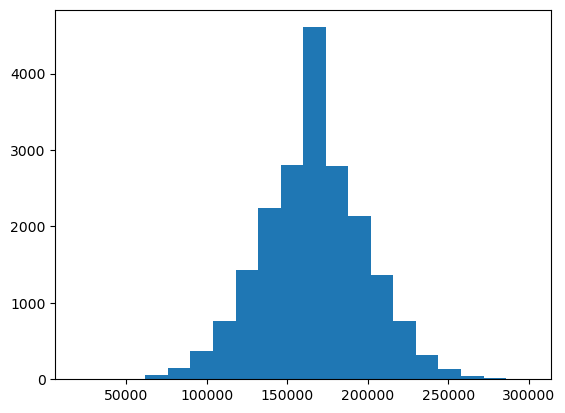

In [15]:
# this function gives us a histogram of the given column, which we can use to decide the distribution of the column

plt.hist(loan_defaults["rep_income"], bins=20)
plt.show()

d. I would say that the distribution is fairly normal, it could be argued that it is slightly skewed, but I would decide that this distribution is normal.

In [16]:
# this function groups the data by the education level and tells the amount in each group that 
#defaulted on their loans

grouped = loan_defaults.groupby("rep_education")["Def_ind"].sum()
grouped

rep_education
college        1177
graduate        197
high_school     615
other            11
Name: Def_ind, dtype: int64

e. According to this data, those with college degrees are more likely to default on loans.

f. One thing that stands out is that many of the variables are highly correlated, if they are not missing values, or imbalanced, then they all seem to be correlated. There is lots of Multicollinearity going on between the variables.

In [17]:
# these functions give numberical values to the categorical variable rep_education so that it is easier for the 
# model to be used, when there is only one categorical variable it complicates things so this is to make it 
# easier and for the code to run without errors

loan_defaults['rep_education'] = loan_defaults['rep_education'].replace(['high_school'], '0')
loan_defaults['rep_education'] = loan_defaults['rep_education'].replace(['college'], '1')
loan_defaults['rep_education'] = loan_defaults['rep_education'].replace(['graduate'], '2')
loan_defaults['rep_education'] = loan_defaults['rep_education'].replace(['other'], '3')
loan_defaults

,tot_balance,avg_bal_cards,credit_age,credit_age_good_account,credit_card_age,num_acc_30d_past_due_12_months,num_acc_30d_past_due_6_months,num_mortgage_currently_past_due,tot_amount_currently_past_due,num_inq_12_month,...,num_card_12_month,num_auto_ 36_month,uti_open_card,pct_over_50_uti,uti_max_credit_line,pct_card_over_50_uti,ind_XYZ,rep_income,rep_education,Def_ind
0,102956.11010,14819.057400,238,104,264,0,0,0,0.000000,0,...,1,0,0.366737,0.342183,0.513934,0.550866,0,118266.321300,1,0
1,132758.72580,18951.934550,384,197,371,0,0,0,0.000000,0,...,0,0,0.490809,0.540671,0.418016,0.550964,0,89365.057650,1,0
2,124658.91740,15347.929690,277,110,288,0,0,0,0.000000,0,...,0,0,0.359074,0.338560,0.341627,0.451417,0,201365.121300,1,0
3,133968.53690,14050.713340,375,224,343,0,0,0,0.000000,2,...,1,0,0.700379,0.683589,0.542940,0.607843,0,191794.485500,1,0
4,143601.80170,14858.515270,374,155,278,0,0,0,0.000000,0,...,0,0,0.647351,0.510812,0.632934,0.573680,0,161465.367900,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,89665.13930,11521.159950,319,139,363,0,0,0,0.000000,0,...,0,0,0.535628,0.634712,0.527230,0.602345,0,166373.900129,0,0
19996,136211.63530,17977.054130,297,137,273,0,0,0,0.000000,2,...,0,0,0.464774,0.450030,0.545108,0.550964,1,166373.900129,0,0
19997,110721.87650,13316.820540,304,151,257,0,0,0,0.000000,0,...,0,0,0.264544,0.340289,0.412155,0.550964,0,157706.158100,1,0
19998,96742.36371,11743.262370,275,141,294,2,1,1,3009.387661,0,...,0,0,0.609226,0.582007,0.301612,0.697052,1,97387.974140,1,1


In [18]:
# this function splits the data by a given percentage, in this case I had it split 80% for the training set and 20%
# for the test set

y = loan_defaults["Def_ind"]
x = loan_defaults.loc[:, loan_defaults.columns != "Def_ind"] 
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=7)

In [19]:
# this function creates a logistic regression object that we can use to fit a model

LR_model = LogisticRegression()

In [20]:
# this function uses the training set to fit a model

LR_model.fit(X_train, y_train)

LogisticRegression()

In [21]:
# this function uses the test set and model to predict the response variable

y_pred = LR_model.predict(X_test)
y_pred

array([0, 0, 0, ..., 0, 1, 0])

In [22]:
# these functions give us the accuracy, precision, and recall scores of the model, 
# in this case they are all the same

accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='micro')
recall = recall_score(y_test, y_pred, average='micro')
print(accuracy)
print(precision)
print(recall)

0.9005
0.9005
0.9005


3. The accuracy score for this model is 0.9005, which means that the percentage of correctly identified sample units in the model was 90.05%. The precision score of this model is .9005, which means that the percentage of correctly identified positive sample units in the model was 90.05%. The recall score for this moldel is .9005, which means that the percentage of correctly identified positive cases for this model was 90.05%. These are fairly good percentages so I would say that the model is fairly good.

In [23]:
# this function produces a confusion matrix of the model

matrix = confusion_matrix(y_test, y_pred)
matrix

array([[3573,   19],
       [ 379,   29]])

4. According to the confusion matrix, the model accurately predicted 3573 true positives, 379 false positives, 19 false negatives, and 29 true negatives. This means that in total the model accurately predicted 3602 units, and did not accurately predict 398 units. 

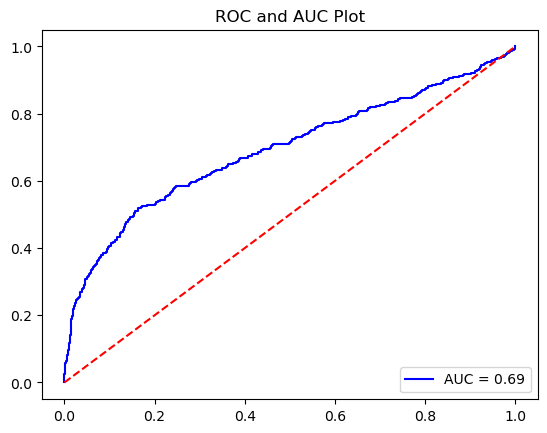

In [24]:
# these functions first find the ROC and AUC scores first, and then are used to create a plot of the ROC and AUC

probs = LR_model.predict_proba(X_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)

plt.plot(fpr,tpr,'b', label = 'AUC = %0.2f' % roc_auc)
plt.plot([0,1], [0,1], 'r--')
plt.title("ROC and AUC Plot")
plt.legend(loc = 'lower right')
plt.show()

5. The ROC curve shows us that the model does do fairly well as it is moving towards the top left corner, but as we can see there is plenty of room for improvement within the model. The AUC score is also telling that the model does well but could be improved, 0.69 is not bad but could be better,

In [25]:
# this for loop goes through the features and finds their corresponding coefficient so that we can decide which
# feature is most important to the response variable, Def_ind

importance = LR_model.coef_[0]
for i, v in enumerate(importance):
 print('Feature: %0d, Score: %.5f' % (i,v))

Feature: 0, Score: 0.00000
Feature: 1, Score: -0.00012
Feature: 2, Score: -0.00212
Feature: 3, Score: -0.00088
Feature: 4, Score: -0.00172
Feature: 5, Score: 0.00001
Feature: 6, Score: 0.00000
Feature: 7, Score: 0.00000
Feature: 8, Score: 0.00026
Feature: 9, Score: 0.00004
Feature: 10, Score: 0.00006
Feature: 11, Score: 0.00000
Feature: 12, Score: 0.00000
Feature: 13, Score: 0.00001
Feature: 14, Score: 0.00000
Feature: 15, Score: 0.00000
Feature: 16, Score: 0.00000
Feature: 17, Score: -0.00000
Feature: 18, Score: 0.00000
Feature: 19, Score: -0.00001


6. The most important features for predicting default status are tot_amount_currently_past_due, num_inq_12_month, and num_inq_24_month.

## 2

In [26]:
# this function reads in the data set

phone_prices= pd.read_csv("/Users/christinegurek/Desktop/GitHub/DATA-300-Statistical-Machine-Learning-Fall-2023-/Data/mobile_phone_prices.csv")
phone_prices

,battery_power,bluetooth,clock_speed,dual_sim,front_camera,four_g,int_memory,mobile_depth,mobile_weight,number_of cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,...,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,...,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,...,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,...,336,670,869,18,10,19,1,1,1,0


In [27]:
# this fuunction gives us the shape of the data, in this case there are 2000 rows and 21 columns

phone_prices.shape

(2000, 21)

In [28]:
# this function gives the different column names in the data set

phone_prices.columns

Index(['battery_power', 'bluetooth', 'clock_speed', 'dual_sim', 'front_camera',
       'four_g', 'int_memory', 'mobile_depth', 'mobile_weight',
       'number_of cores', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w',
       'talk_time', 'three_g', 'touch_screen', 'wifi', 'price_range'],
      dtype='object')

In [29]:
# this function runs many explanatory tests on the data to give us a better picture of what the data may look like 
# or characteristics of the data that we may not see through manual EDA

pp.ProfileReport(phone_prices)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [30]:
# this function tells us if there are any missing values in the data 
# and which columns the missing data is in,
# in this case there is not any missing values

phone_prices.isna().sum()

battery_power      0
bluetooth          0
clock_speed        0
dual_sim           0
front_camera       0
four_g             0
int_memory         0
mobile_depth       0
mobile_weight      0
number_of cores    0
pc                 0
px_height          0
px_width           0
ram                0
sc_h               0
sc_w               0
talk_time          0
three_g            0
touch_screen       0
wifi               0
price_range        0
dtype: int64

1. This data is fairly good to work with. There are no missing values so we do not need to impute any. The classes seem to be balanced. The only concern may be that there is lots of mutlicollinearity in the variables, which we may need to take into account when we judge the model.

In [31]:
# this function splits the data into the test set and data set, in this one I chose to have 80% of the data set
# be in the training set and 20% of the data set in the test set

y = phone_prices["price_range"]
x = phone_prices.loc[:, phone_prices.columns != "price_range"] 
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=7)

In [32]:
# this function creates a linear discriminant analysis object that we can use to fit a model

LDA_model = LinearDiscriminantAnalysis()

In [33]:
# this function fits the model

LDA_model.fit(X_train, y_train)

LinearDiscriminantAnalysis()

In [34]:
# this function uses the model to predict the response variable

y_pred = LDA_model.predict(X_test)
y_pred

array([3, 3, 2, 1, 0, 2, 3, 1, 1, 2, 0, 0, 2, 0, 0, 0, 1, 1, 0, 1, 2, 1,
       2, 1, 2, 1, 3, 1, 2, 3, 3, 0, 0, 2, 3, 2, 3, 2, 1, 3, 2, 3, 2, 0,
       2, 1, 0, 3, 1, 0, 1, 3, 2, 0, 2, 2, 1, 2, 3, 3, 1, 1, 1, 3, 0, 3,
       3, 1, 0, 3, 0, 0, 0, 1, 1, 0, 2, 0, 0, 2, 1, 3, 2, 1, 1, 0, 1, 2,
       1, 3, 1, 3, 3, 0, 0, 3, 1, 0, 2, 1, 2, 0, 2, 2, 0, 1, 0, 2, 2, 2,
       3, 2, 2, 0, 0, 2, 0, 2, 0, 3, 2, 1, 0, 2, 3, 0, 1, 0, 0, 2, 3, 2,
       1, 0, 3, 1, 3, 1, 1, 0, 1, 0, 2, 3, 3, 1, 0, 1, 2, 0, 2, 0, 3, 1,
       2, 1, 2, 1, 2, 3, 2, 2, 1, 2, 0, 0, 2, 3, 2, 3, 0, 1, 1, 0, 1, 0,
       3, 2, 1, 0, 2, 3, 3, 0, 0, 3, 1, 2, 0, 0, 0, 2, 2, 2, 1, 0, 0, 1,
       3, 0, 0, 2, 2, 0, 0, 1, 3, 0, 1, 0, 0, 2, 2, 1, 1, 2, 3, 3, 1, 2,
       2, 0, 3, 1, 3, 2, 2, 2, 0, 3, 2, 0, 2, 0, 1, 0, 3, 1, 0, 3, 3, 3,
       1, 1, 1, 2, 2, 3, 0, 1, 3, 0, 0, 1, 2, 2, 3, 3, 3, 1, 1, 1, 1, 3,
       0, 3, 1, 2, 2, 3, 2, 3, 2, 0, 0, 3, 3, 2, 1, 1, 3, 3, 2, 1, 3, 2,
       0, 3, 2, 3, 2, 3, 1, 2, 1, 0, 2, 1, 2, 0, 0,

In [35]:
# these functions are used to produce the accuracy, precision, and recall scores of the model, 
# in this case they are all the same

accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='micro')
recall = recall_score(y_test, y_pred, average='micro')
print(accuracy)
print(precision)
print(recall)

0.945
0.945
0.945


4. The accuracy score for this model is 0.945, which means that the percentage of correctly identified sample units in the model was 94.5%. The precision score of this model is .945, which means that the percentage of correctly identified positive sample units in the model was 94.5%. The recall score for this moldel is .945, which means that the percentage of correctly identified positive cases for this model was 94.5%. These are very good percentages so I would say that the model is very good.

In [36]:
# this function creates a confusion matrix for the model

matrix = confusion_matrix(y_test, y_pred)
matrix

array([[103,   6,   0,   0],
       [  0,  86,   3,   0],
       [  0,   9,  97,   0],
       [  0,   0,   4,  92]])

5. According to the confusion matrix, the model accurately predicted 103 units in the 0 price range, 86 units in the 1 price range, 97 units in the 2 price range, and 92 units in the 3 price range. I inaccuratly predicted 6 units in the 1 price range when they are actually in the 0 price range, 3 units in the 2 price range when they are actually in the 1 price range, 9 units in the 1 price range when they are actually in the 2 price range, and 3 units in the 2 price range when they are actually in the 3 price range. Thus in total, the model accurately predicted 378 units and inaccurately predicted 22 units.